In [1]:
import os
os.chdir("../../")
print(os.getcwd()) #You should be in p-DynSys_EncoderTransformerDecoder folder

C:\Users\ismae\Desktop\PhD_codes\EncoderTransformerDecoder


In [2]:
import torch, os
from scipy import interpolate
from torch.utils.data import Dataset, DataLoader
from src.PreProc_Data.DataProc import StackedSequenceDataset
import numpy as np
from src.Eval import Eval
import matplotlib.pyplot as plt
import pandas as pd
import csv

In [3]:
exp_dir = "Trained_Models/2DCyl_new"
exp_name= "sl9_obs4_bs64_attblks1_atthds8_tr0_ph10_lbdaStateLoss1.0_nhd64_0.0002__"

models = Eval_MZA(exp_dir, exp_name)

########## Imp Info ##########
System:  2DCyl


Epoch with Minimum train_error:  2391
Epoch with Minimum test_error:  2303


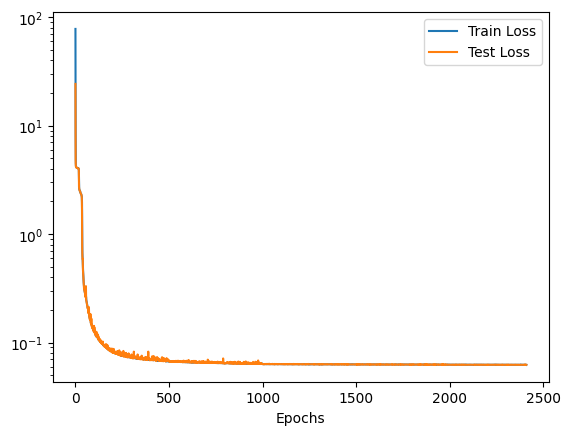

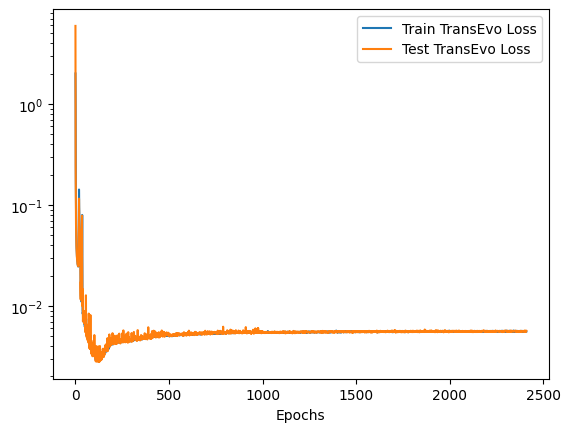

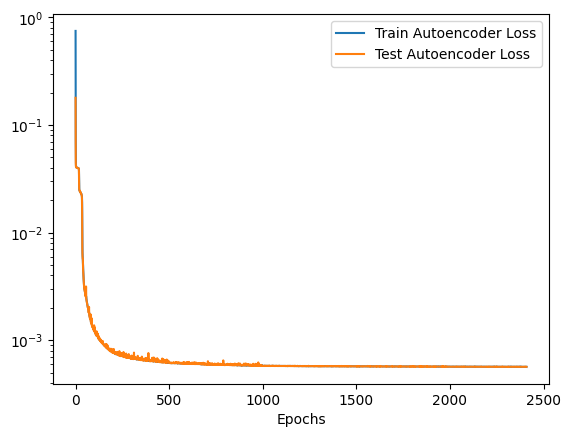

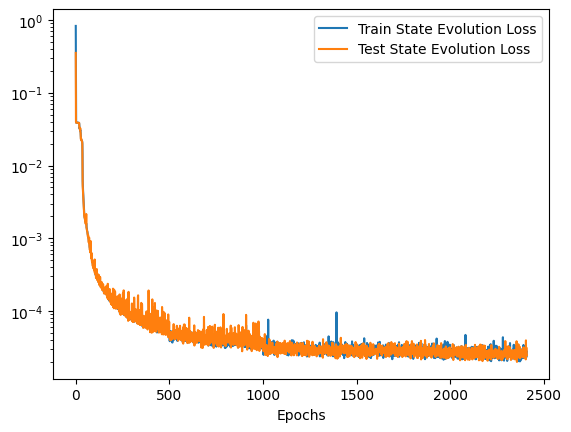

In [4]:
import matplotlib as mpl
csfont = {'fontname':'Times New Roman'}
mpl.rcParams['axes.labelsize'] = 10
mpl.rcParams['xtick.labelsize'] = 10
mpl.rcParams['ytick.labelsize'] = 10
mpl.rcParams['legend.fontsize'] = 10
models.plot_learning_curves()
models.load_weights(min_train_loss = True)

In [5]:
if torch.cuda.is_available():
    device = torch.device("cuda")
elif torch.backends.mps.is_available():
    device = torch.device("mps") 
else:
    device = torch.device("cpu")
print(device) 

Re_arr = [50, 60, 70, 80, 90, 100, 110, 120, 130, 140]
train_Re_arr = [90,120]
file_location  = "Data/2DCylinder/processed_data/npyfiles/"
filename = "adaptive_sampling_test.npy"
data_set = np.load(file_location + filename)
test_set = torch.tensor(data_set[:, 1::2, :], dtype = torch.float32).to(device) 
print(test_set.shape) #You should have a [10, 1516, 6551] torch tensor 

torch.Size([10, 1516, 6551])


In [6]:
x_ms_hat, Phi_ms_hat= [], []
timesteps = 2000

for i in range(test_set.shape[0]):
  
    initial_condition = test_set[i, 0, :]
    initial_Phi, context = torch.split(initial_condition, [initial_condition.shape[-1]-1, 1], dim=-1)
    x_hat_temp, Phi_hat_temp = models.predict_multistep(initial_Phi.unsqueeze(0), timesteps, context.unsqueeze(0))

    x_ms_hat.append(x_hat_temp)
    Phi_ms_hat.append(Phi_hat_temp)
    print(Re_arr[i], x_hat_temp.shape, Phi_hat_temp.shape)

x_ms_hat = torch.cat(x_ms_hat, dim = 0)
Phi_ms_hat = torch.cat(Phi_ms_hat, dim = 0)

50 torch.Size([1, 2001, 4]) torch.Size([1, 2001, 6550])
60 torch.Size([1, 2001, 4]) torch.Size([1, 2001, 6550])
70 torch.Size([1, 2001, 4]) torch.Size([1, 2001, 6550])
80 torch.Size([1, 2001, 4]) torch.Size([1, 2001, 6550])
90 torch.Size([1, 2001, 4]) torch.Size([1, 2001, 6550])
100 torch.Size([1, 2001, 4]) torch.Size([1, 2001, 6550])
110 torch.Size([1, 2001, 4]) torch.Size([1, 2001, 6550])
120 torch.Size([1, 2001, 4]) torch.Size([1, 2001, 6550])
130 torch.Size([1, 2001, 4]) torch.Size([1, 2001, 6550])
140 torch.Size([1, 2001, 4]) torch.Size([1, 2001, 6550])


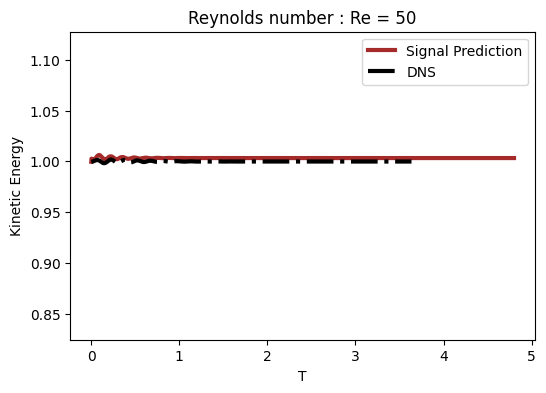

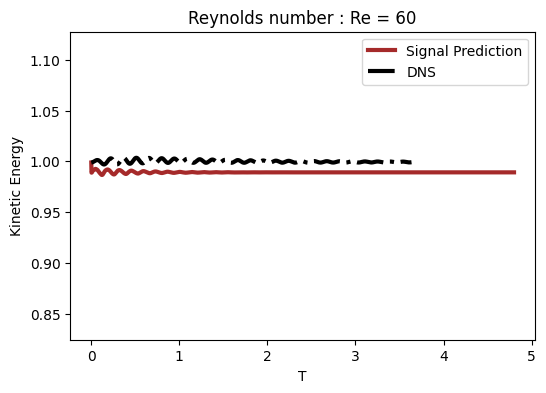

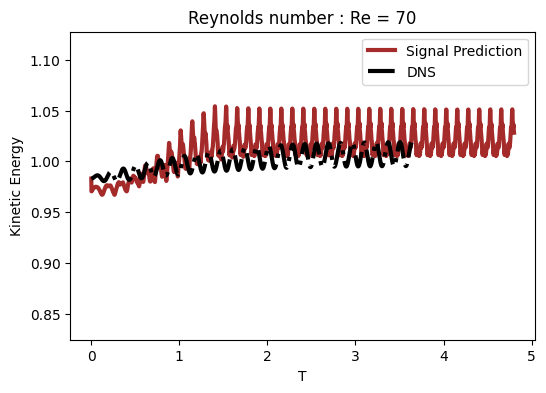

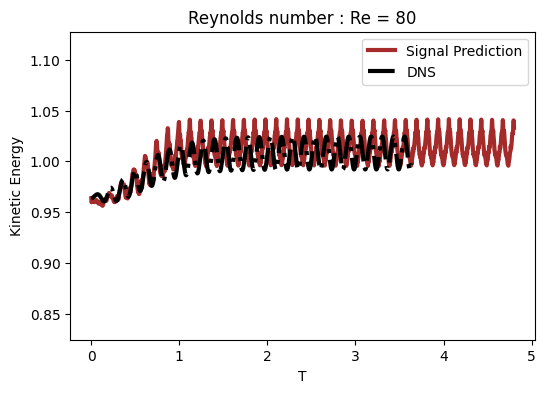

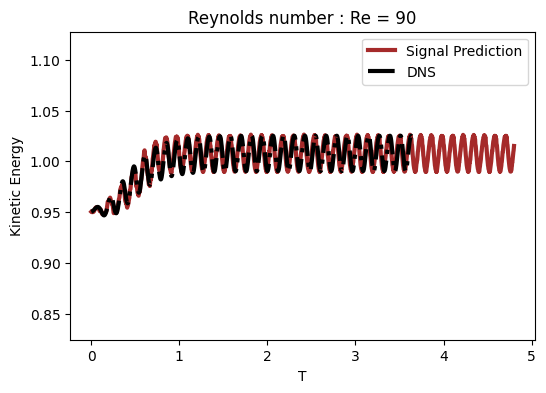

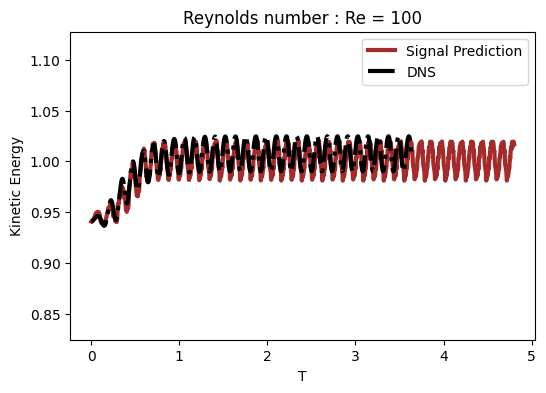

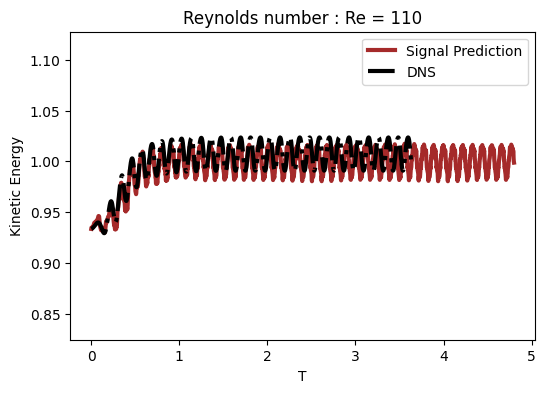

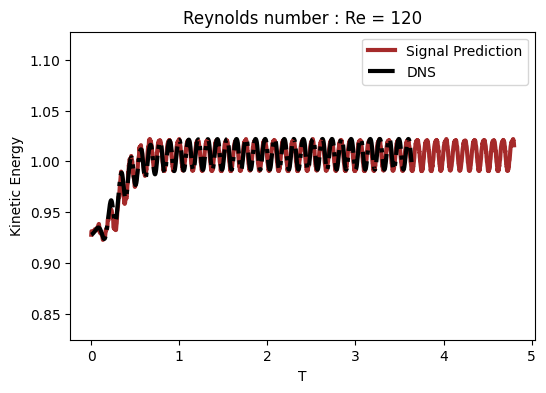

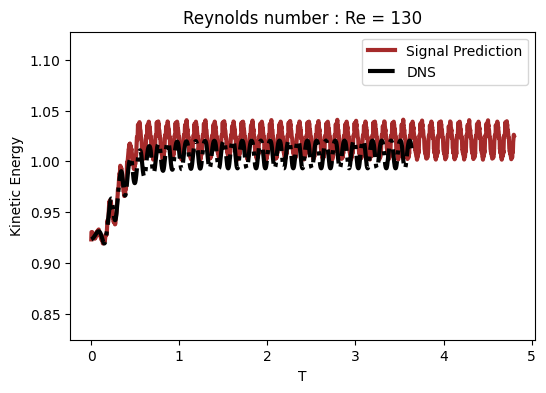

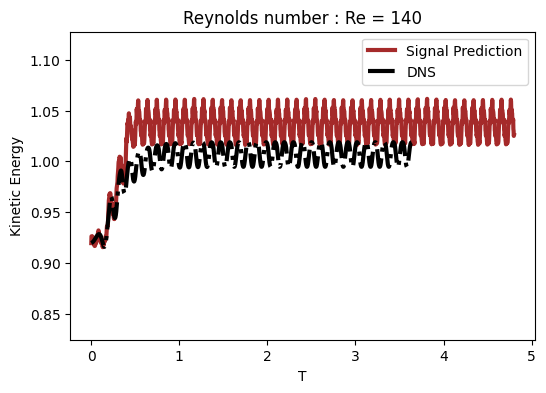

In [7]:
def energy(u, v):
    """
    Computes Kinetic Energy over T timesteps (time T*dt with dt : 0.024 seconds)
    Inputs : 
    u : numpy.ndarray [T, D] with D the spatial dimension 
    v : numpy.ndarray [T,D]

    returns : 
    k : numpy.ndarray [T,] 
    """
    k = 0.5 * (np.mean(u**2, axis=-1) + np.mean(v**2, axis=-1))
    return k
    
    
U_ms_hat = Phi_ms_hat[...,:int(Phi_ms_hat.shape[-1]/2)].detach().cpu().numpy()
V_ms_hat = Phi_ms_hat[...,int(Phi_ms_hat.shape[-1]/2):].detach().cpu().numpy()


U = test_set[...,:int(test_set.shape[-1]/2)].detach().cpu().numpy()
V = test_set[...,int(test_set.shape[-1]/2):].detach().cpu().numpy()

k = energy(U, V)
k_ms_pred = energy(U_ms_hat, V_ms_hat)



for i in range(len(Re_arr)) : 
    plt.figure(figsize=(6, 4))
    plt.plot(np.arange(k_ms_pred.shape[-1])*0.0024, k_ms_pred[i, :], color = "brown", label="Signal Prediction", linewidth = 3)
    plt.plot(np.arange(k.shape[-1]) * 0.0024, k[i, :], label="DNS", color="black", linewidth = 3,linestyle = 'dashdot')
    plt.ylim(np.min(k)*0.9, np.max(k)*1.1)
    plt.title(f'Reynolds number : Re = {Re_arr[i]}')
    plt.legend()
    plt.xlabel(r"T")
    plt.ylabel("Kinetic Energy")
    plt.show()

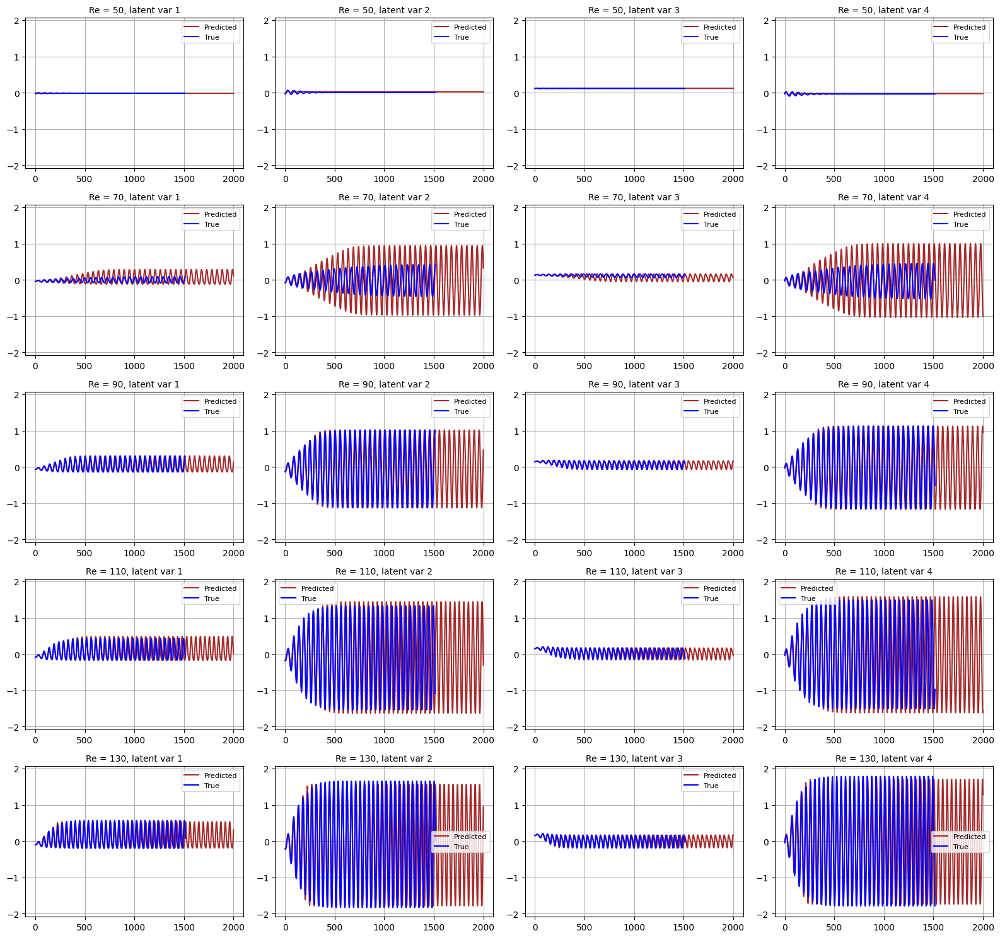

In [8]:
Phi, context = torch.split(test_set, [test_set.shape[-1]-1, 1], dim=-1)
mu_test, log_var_test = models.get_latent_dynamics(Phi, context)

i_values = list(range(0, mu_test.shape[0], 2))
num_rows = len(i_values)
num_cols = mu_test.shape[2]

fig, axs = plt.subplots(num_rows, num_cols, figsize=(4*num_cols, 3*num_rows), squeeze=False)

ymin = np.min(mu_test.detach().cpu().numpy()) * 1.1
ymax = np.max(mu_test.detach().cpu().numpy()) *1.1

for row_idx, i in enumerate(i_values):
    for col_idx in range(num_cols):
        ax = axs[row_idx, col_idx]
        
        x_pred = x_ms_hat[i, :, col_idx].detach().cpu().numpy()
        x_true = mu_test[i, :, col_idx].detach().cpu().numpy()
        
        ax.plot(np.arange(x_pred.shape[0]), x_pred, color="brown", label="Predicted")
        ax.plot(np.arange(x_true.shape[0]), x_true, color="blue", label="True")
        
        ax.set_ylim(ymin, ymax)
        ax.set_title(f"Re = {Re_arr[i]}, latent var {col_idx+1}", fontsize=10)
        ax.legend(fontsize=8)
        ax.grid(True)

plt.tight_layout()
plt.show()

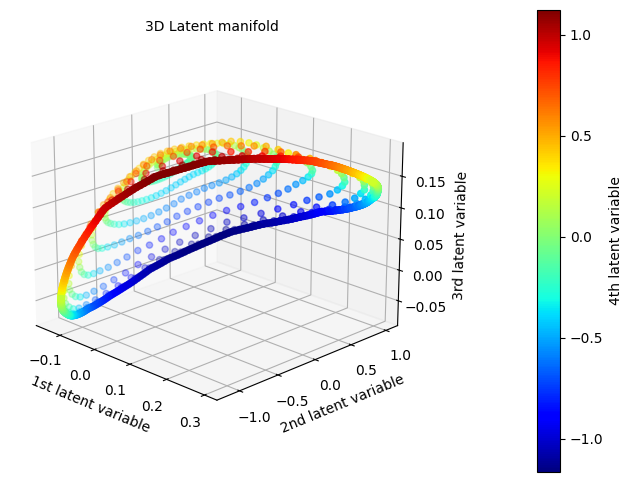

In [9]:
from mpl_toolkits.mplot3d import Axes3D 
from scipy.interpolate import Rbf

Re = 90 #Enter the Reynolds number you want to see the late,nt embedding 
index = Re_arr.index(Re)
latent_embedding  = x_ms_hat[index, ...].detach().cpu().numpy()

fig = plt.figure(figsize=(8,6))
ax = fig.add_subplot(111, projection='3d')

x = latent_embedding[:, 0]
y = latent_embedding[:, 1]
z = latent_embedding[:, 2]
c = latent_embedding[:, 3]

sc = ax.scatter(x, y, z, c=c, cmap='jet') 
fig.colorbar(sc, ax=ax, label='4th latent variable', pad=0.2)

ax.set_xlabel('1st latent variable', fontsize = 10)
ax.set_ylabel('2nd latent variable', fontsize = 10)
ax.set_zlabel('3rd latent variable', fontsize = 10)
ax.set_title('3D Latent manifold', fontsize = 10)
ax.view_init(elev=20, azim=-45) #Play with the view angles here (e.g elev = 90, azim  = 0 / elev = 0, azim = 90)
plt.show()


In [10]:
#Run time about 5-10 minutes

from matplotlib.animation import FuncAnimation, PillowWriter 
from IPython.display import HTML

Re = 90
index = Re_arr.index(Re)
latent_embedding = x_ms_hat[index, ...].detach().cpu().numpy()

x = latent_embedding[:, 0]
y = latent_embedding[:, 1]
z = latent_embedding[:, 2]
c = latent_embedding[:, 3]

fig = plt.figure(figsize=(8,6))
ax = fig.add_subplot(111, projection='3d')

sc = ax.scatter(x, y, z, c=c, cmap='jet')
cbar = fig.colorbar(sc, ax=ax, pad=0.2)
cbar.set_label('4th latent variable')

ax.set_xlabel('1st latent variable')
ax.set_ylabel('2nd latent variable')
ax.set_zlabel('3rd latent variable')
ax.set_title('3D Latent manifold')

frames = 90
elev_start, azim_start = 20, -45

def update(frame): #360 degrees rotation
    elev = elev_start + frame*4
    azim = azim_start + frame*4
    ax.view_init(elev=elev, azim=azim)
    return sc,

anim = FuncAnimation(fig, update, frames=frames, interval=50, blit=False)
anim.save('latent_manifold.gif', writer='pillow', dpi=150)

plt.close(fig)

In [11]:
HTML(anim.to_jshtml())

In [13]:
from scipy.special import erf

def stretching(n, dn0, dn1, ns, ws=12, we=12, maxs=0.04):
    """Return stretched segment.
    Parameters
    ----------
    n : int
        Total number of points.
    dn0 : float
        Initial grid spacing.
    dn1 : float
        Final grid spacing.
    ns : int
        Number of grid points with spacing equal to dn0
    ws : int, optional
        Number of grid points from stretching zero to stretching maxs
    we : int, optional
        Number of grid points from stretching maxs to stretching zero
    maxs : float, optional
        Maximum stretching (ds_i+1 - ds_i)/ds_i
    Returns
    -------
    f: np.ndarray
        One-dimensional np.array
    """
    ne = ns + np.log(dn1 / dn0) / np.log(1 + maxs)
    s = np.array([maxs * 0.25 * (1 + erf(6 * (x - ns) / (ws))) * (1 - erf(6 * (x - ne) / we)) for x in range(n)])
    f_ = np.empty(s.shape)
    f_[0] = dn0
    for k in range(1, len(f_)):
        f_[k] = f_[k - 1] * (1 + s[k])
    f = np.empty(s.shape)
    f[0] = 0.0
    
    for k in range(1, len(f)):
        f[k] = f[k - 1] + f_[k]
        
    return f

s1 = stretching(256, 0.033, 0.20, int(0.5/0.033+16), 16, 16, 0.04)
s2 = stretching(128, 0.033, 0.20, int(0.5/0.033+16), 16, 16, 0.04)
s = stretching(192, 0.033, 0.20, int(0.5/0.033+16), 16, 16, 0.04)
x = np.r_[-s2[::-1], s1[1:]]
y = np.r_[-s[::-1], s[1:]]

a, b, c, d = -1.5, -2, 2, 8 #Used to zoom in the dynamical region of interest

indices_x = np.where((x > a) & (x < d))[0]
indices_y = np.where((y > b) & (y < c))[0]
x_low, x_high = indices_x[0], indices_x[-1]
y_low, y_high = indices_y[0], indices_y[-1]
x = x[x_low : x_high]
y = y[y_low : y_high]

X, Y = np.meshgrid(x, y, indexing='ij') 

In [14]:
def reshape_to_grid(arr):
   
    interp_func = interpolate.interp1d(np.arange(arr.shape[-1]), arr, axis=-1, kind='linear')

    new_x_values = np.linspace(0, arr.shape[-1]-1, 13100)
    
    grid = interp_func(new_x_values)
    grid_reshaped = grid.reshape(131, 100)
    
    return grid_reshaped

In [15]:
# Visualisation of spatial error : 
Re = 100
index = Re_arr.index(Re)
true_traj = test_set[..., :-1].detach().cpu().numpy() #We remove last value of test_set because it is the parametrization (Re)
_, T, D = true_traj.shape 
inferred_traj = Phi_ms_hat[:, :T, :].detach().cpu().numpy()

err_L2 = (true_traj - inferred_traj)**2
print(err_L2.shape)

(10, 1516, 6550)


In [16]:
Re = 100
timestep = 1000 #Pick any timestep between 0-1516

err_L2_user = err_L2[index, timestep, :]
U_err = err_L2_user[:D//2]
V_err = err_L2_user[D//2:]
U_err_grid = reshape_to_grid(U_err)
V_err_grid = reshape_to_grid(V_err)

U_true = true_traj[index, timestep, :D//2]
V_true = true_traj[index, timestep, D//2:]
U_true_grid = reshape_to_grid(U_true) 
V_true_grid = reshape_to_grid(V_true)

U = inferred_traj[index, timestep, :D//2]
V = inferred_traj[index, timestep, D//2:]
U_grid = reshape_to_grid(U) 
V_grid = reshape_to_grid(V) 

print(U_err_grid.shape, V_err_grid.shape, U_grid.shape, V_grid.shape, U_true_grid.shape, V_true_grid.shape)

(131, 100) (131, 100) (131, 100) (131, 100) (131, 100) (131, 100)


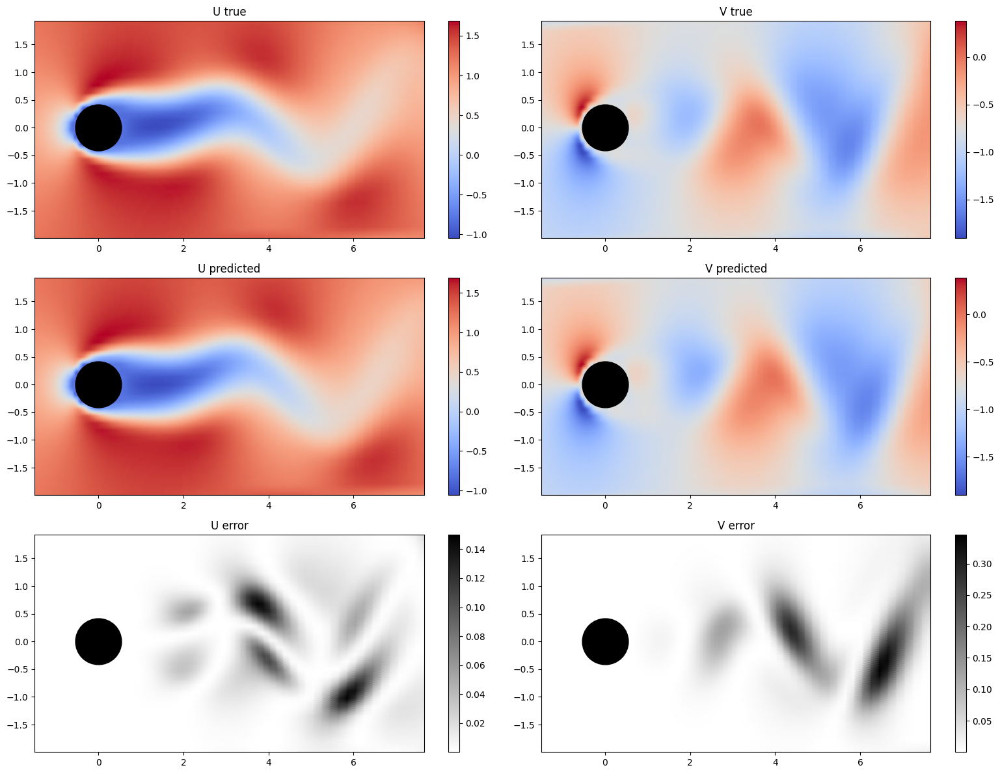

In [17]:
import matplotlib.pyplot as plt

fig, axs = plt.subplots(3, 2, figsize=(16, 12))

data = [
    (U_true_grid, 'U true'),
    (V_true_grid, 'V true'),
    (U_grid, 'U predicted'),
    (V_grid, 'V predicted'),
    (U_err_grid, 'U error'),
    (V_err_grid, 'V error')
]

for i, (grid, title) in enumerate(data):
    ax = axs[i // 2, i % 2]
    if "error" not in title : 
        colormap = ax.pcolormesh(X, Y, grid, cmap='coolwarm', shading='gouraud')
    else : 
        colormap = ax.pcolormesh(X, Y, grid, cmap='binary', shading='gouraud')
    ax.set_title(title)
    ax.scatter(0, 0, s=2600, color='black', marker='o', label = "Obstacle")
    fig.colorbar(colormap, ax=ax)

plt.tight_layout()
plt.show()

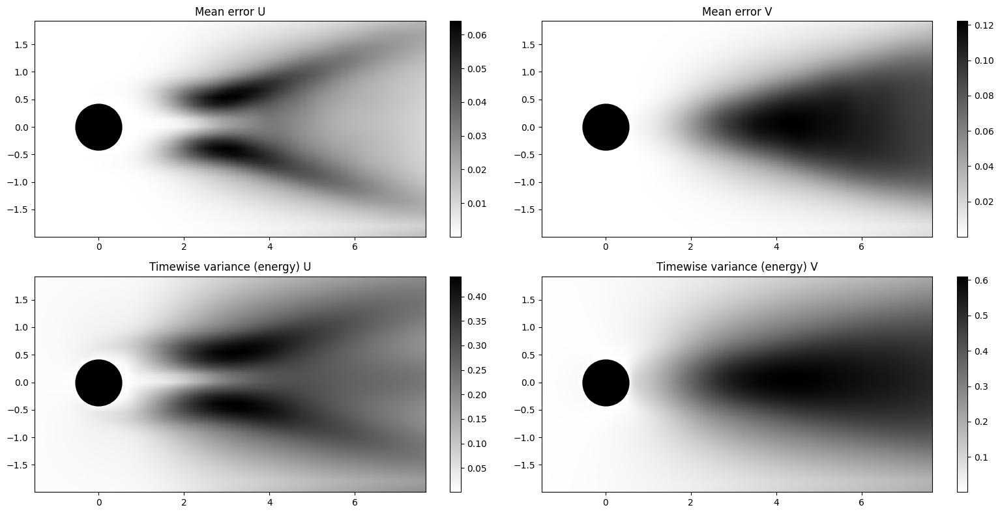

In [18]:
#Error mean : 
Re = 100
index = Re_arr.index(Re)
err_L2_mean = np.mean(err_L2[index,...], axis = 0) 

U_err_mean = reshape_to_grid(err_L2_mean[:D//2])
V_err_mean = reshape_to_grid(err_L2_mean[D//2:])

U = inferred_traj[index, :, :D//2]
V = inferred_traj[index, :, D//2:]

time_variance_U = reshape_to_grid(np.std(U, axis = 0))
time_variance_V = reshape_to_grid(np.std(V, axis = 0))

fig, axs = plt.subplots(2, 2, figsize=(16, 8))

data = [
    (U_err_mean, 'Mean error U'),
    (V_err_mean, 'Mean error V'),
    (time_variance_U, 'Timewise variance (energy) U'),
    (time_variance_V, 'Timewise variance (energy) V')
]

for i, (grid, title) in enumerate(data):
    
    ax = axs[i//2, i % 2]
    colormap = ax.pcolormesh(X, Y, grid, cmap='binary', shading='gouraud')
    ax.set_title(title)
    ax.scatter(0, 0, s=2600, color='black', marker='o', label = "Obstacle")
    fig.colorbar(colormap, ax=ax)

plt.tight_layout()
plt.show()

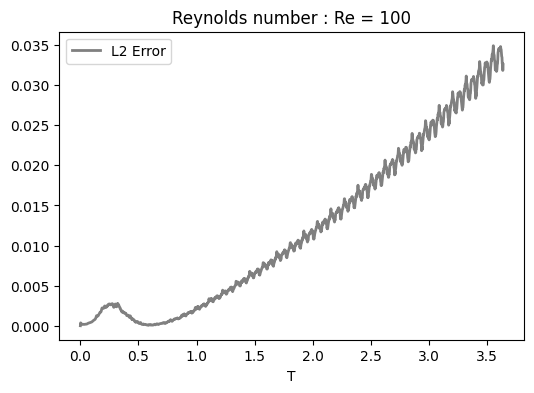

In [19]:
Re = 100
index = Re_arr.index(Re) 

err_L2_t = np.mean(err_L2[index, :, :], axis = 1)

plt.figure(figsize=(6, 4))
plt.title(f'Reynolds number : Re = {Re}') 
plt.plot(np.arange(T)*0.0024, err_L2_t, linewidth = 2, color = "grey", label = "L2 Error") 
plt.xlabel('T')
plt.legend()
plt.show()


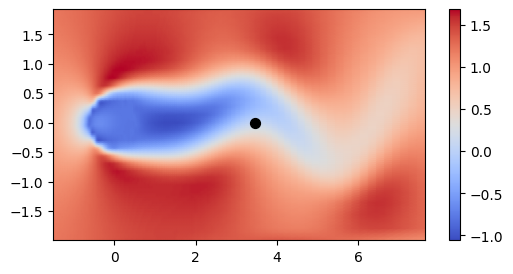

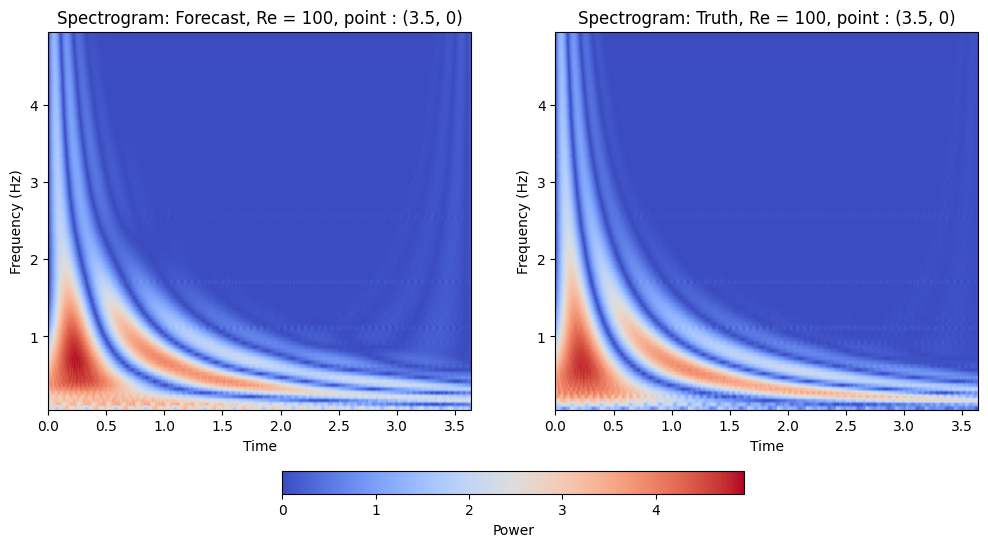

In [20]:
import pywt #Wavelets filtering you may need to run pip install PyWavelets

#Select a point where you want to visualize the spectrogram :
a = 3.5 #Select x coordinates between -1 and 8
b = 0 #select Y coordinates between -2 and 2

Re = 100 #Select Re number 

index = Re_arr.index(Re)

U_hat = inferred_traj[index, : , :D//2]
V_hat = inferred_traj[index, :, D//2:]

U = true_traj[index, : , :D//2]
V = true_traj[index, :, D//2:]

i = np.argmin(np.abs(x - a))
j = np.argmin(np.abs(y - b))

fig = plt.subplots(figsize=(6, 3))

colormap = plt.pcolormesh(X, Y, U_grid, cmap='coolwarm', shading='gouraud')
plt.scatter(x[i], y[j], color= "black", s=50)
plt.colorbar(colormap)

shape = (131,100)
flat_index = np.ravel_multi_index((i, j), shape)//4 #Division by 4 because the data used in the model is downsampled by a factor 4 compared with data generated on teh grid 

signal_hat = U_hat[:, flat_index]
signal_true = U[:, flat_index]

fs = 1 / 0.0024  # Sampling frequency
frequencies = np.arange(0.05, 5, 0.05)  # Hz

# Morlet wavelet center frequency
w_c = pywt.central_frequency('morl')

scales = w_c * fs / frequencies
coeffs_hat, _ = pywt.cwt(signal_hat, scales, 'morl', sampling_period=1/fs)
power_hat = np.abs(coeffs_hat)


coeffs_true, _ = pywt.cwt(signal_true, scales, 'morl', sampling_period=1/fs)
power_true = np.abs(coeffs_true)


fig, axes = plt.subplots(1, 2, figsize=(12, 6), sharex=True)

extent = [0, len(signal_hat)/fs, frequencies[-1], frequencies[0]] 

im0 = axes[0].imshow(power_hat, extent=extent, aspect='auto', cmap='coolwarm')
axes[0].set_title(f'Spectrogram: Forecast, Re = {Re}, point : {(a,b)}')
axes[0].set_ylabel('Frequency (Hz)')
axes[0].set_xlabel('Time')
axes[0].invert_yaxis()  

im1 = axes[1].imshow(power_true, extent=extent, aspect='auto', cmap='coolwarm')
axes[1].set_title(f'Spectrogram: Truth, Re = {Re}, point : {(a,b)}')
axes[1].set_ylabel('Frequency (Hz)')
axes[1].set_xlabel('Time')
axes[1].invert_yaxis()  

vmin = min(im0.get_array().min(), im1.get_array().min())
vmax = max(im0.get_array().max(), im1.get_array().max())

for im in [im0, im1]:
    im.set_clim(vmin, vmax)

cbar = fig.colorbar(im1, ax=axes, orientation='horizontal', fraction=0.05, pad=0.15, label='Power')
plt.subplots_adjust(bottom=0.25)
plt.show()

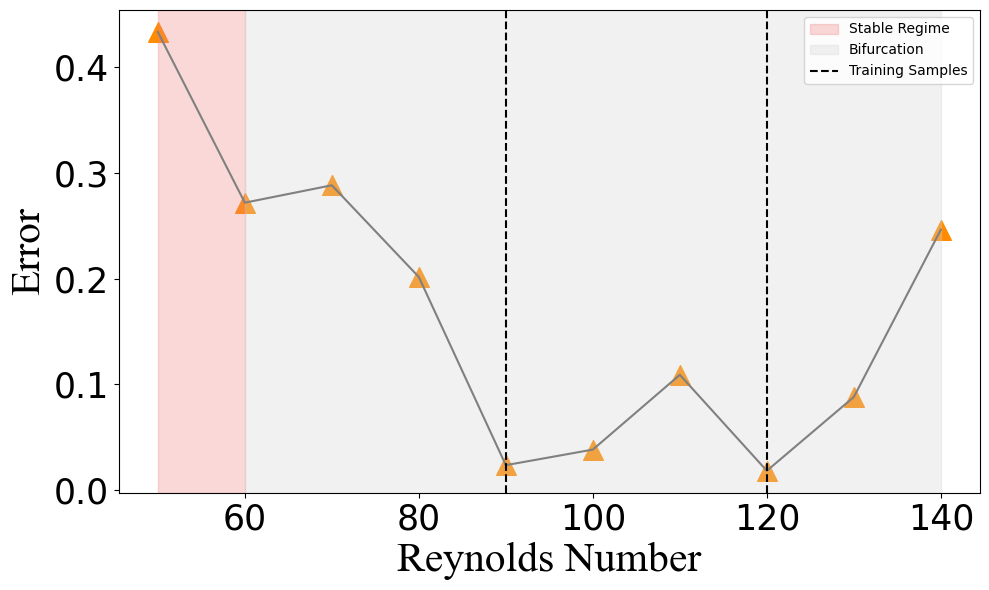

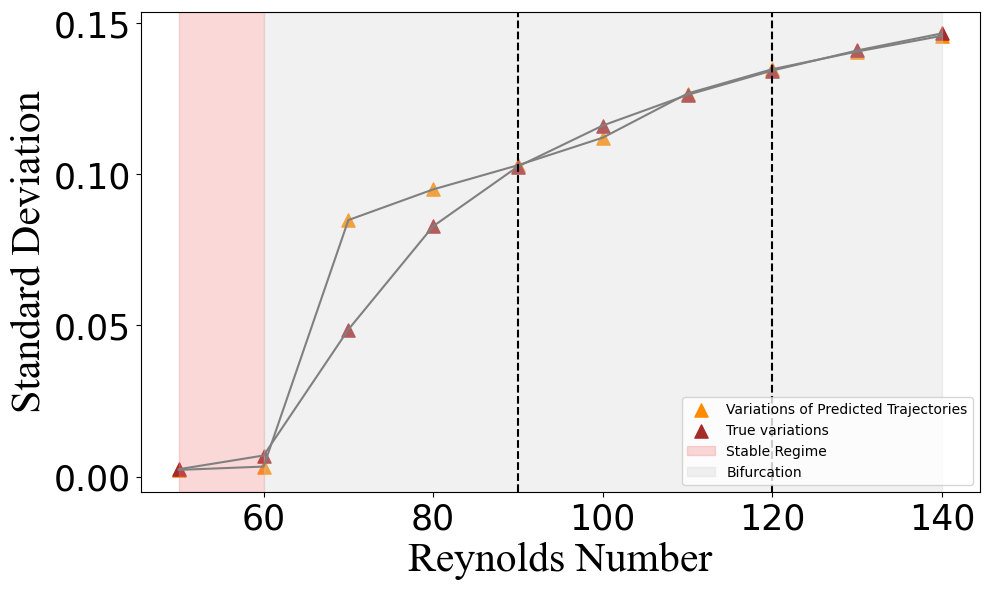

In [21]:
import matplotlib as mpl 

csfont = {'fontname':'Times New Roman'}
mpl.rcParams['axes.labelsize'] = 30
mpl.rcParams['xtick.labelsize'] = 25
mpl.rcParams['ytick.labelsize'] = 25

error_list = []
true_std_list = []
std_list = []

for param in range(test_set.shape[0]) :

    re = Re_arr[param]

    Phi_pred = inferred_traj[param, :, :]
    Phi_test = true_traj[param, :, :]

    true_std = np.std(Phi_test, axis = 0)
    true_mean = np.mean(Phi_test, axis = 0)
    inferred_std = np.std(Phi_pred, axis = 0)
    
    err_scaled_unstat = (Phi_pred - Phi_test)**2 / true_std
    err_scaled_stat = (Phi_pred - true_mean)**2 / true_mean
    gamma = min(1, np.mean(true_std)/0.025)
    scaled_mse = (1-gamma)*np.mean(err_scaled_stat) + gamma*np.mean(err_scaled_unstat)
    
    error_list.append(scaled_mse)
    true_std_list.append(np.mean(true_std))
    std_list.append(np.mean(inferred_std))


error_list = np.array(error_list)
std_list = np.array(std_list)
true_std_list = np.array(true_std_list)

plt.figure(figsize=(10, 6))

plt.plot(Re_arr, error_list, color='grey')
plt.scatter(Re_arr, error_list, color='darkorange', marker='^', s=200)  # Larger markers
plt.axvspan(Re_arr[0], 60, color='lightcoral', alpha=0.3, label = 'Stable Regime')
plt.axvspan(60, Re_arr[-1], color='lightgrey', alpha=0.3, label = 'Bifurcation')
plt.axvline(x=90, color='black', linestyle='--', alpha = 1, label = 'Training Samples')
plt.axvline(x=120, color='black', linestyle='--', alpha = 1)
plt.locator_params(axis='y', nbins=5)
plt.legend(loc='upper right', fontsize=10)
plt.xlabel('Reynolds Number', **csfont)
plt.ylabel('Error', **csfont)
plt.tight_layout()
plt.show()   

plt.figure(figsize=(10, 6))

plt.plot(Re_arr, std_list, color='grey')
plt.scatter(Re_arr, std_list, color='darkorange', marker='^', s=90, label='Variations of Predicted Trajectories')
plt.plot(Re_arr, true_std_list, color='grey')
plt.scatter(Re_arr, true_std_list, color='brown', marker='^', label='True variations', s=90)
plt.axvspan(Re_arr[0], 60, color='lightcoral', alpha=0.3, label='Stable Regime')
plt.axvspan(60, Re_arr[-1], color='lightgrey', alpha=0.3, label='Bifurcation')
plt.locator_params(axis='y', nbins=5)
plt.axvline(x=90, color='black', linestyle='--', alpha = 1)
plt.axvline(x=120, color='black', linestyle='--', alpha = 1)
plt.xlabel('Reynolds Number', **csfont)
plt.ylabel('Standard Deviation', **csfont)
plt.tight_layout()
plt.legend(loc='lower right', fontsize=10)
plt.show()

In [20]:
Re_arr_bif = [60 + i for i in range(10)]
Phi_ms_hat_bif = []
timesteps = 2000

initial_condition_index = Re_arr.index(60)
for i in range(len(Re_arr_bif)):
  
    initial_condition = test_set[initial_condition_index, 0, :]
    initial_Phi, _ = torch.split(initial_condition, [initial_condition.shape[-1]-1, 1], dim=-1)
    context= torch.tensor([Re_arr_bif[i]/140], dtype = torch.float32).to(device)
    x_hat_temp, Phi_hat_temp = models.predict_multistep(initial_Phi.unsqueeze(0), timesteps, context.unsqueeze(0))

    Phi_ms_hat_bif.append(Phi_hat_temp)
    print(Re_arr_bif[i], Phi_hat_temp.shape)

Phi_ms_hat_bif = torch.cat(Phi_ms_hat_bif, dim = 0)

60 torch.Size([1, 2001, 6550])
61 torch.Size([1, 2001, 6550])
62 torch.Size([1, 2001, 6550])
63 torch.Size([1, 2001, 6550])
64 torch.Size([1, 2001, 6550])
65 torch.Size([1, 2001, 6550])
66 torch.Size([1, 2001, 6550])
67 torch.Size([1, 2001, 6550])
68 torch.Size([1, 2001, 6550])
69 torch.Size([1, 2001, 6550])


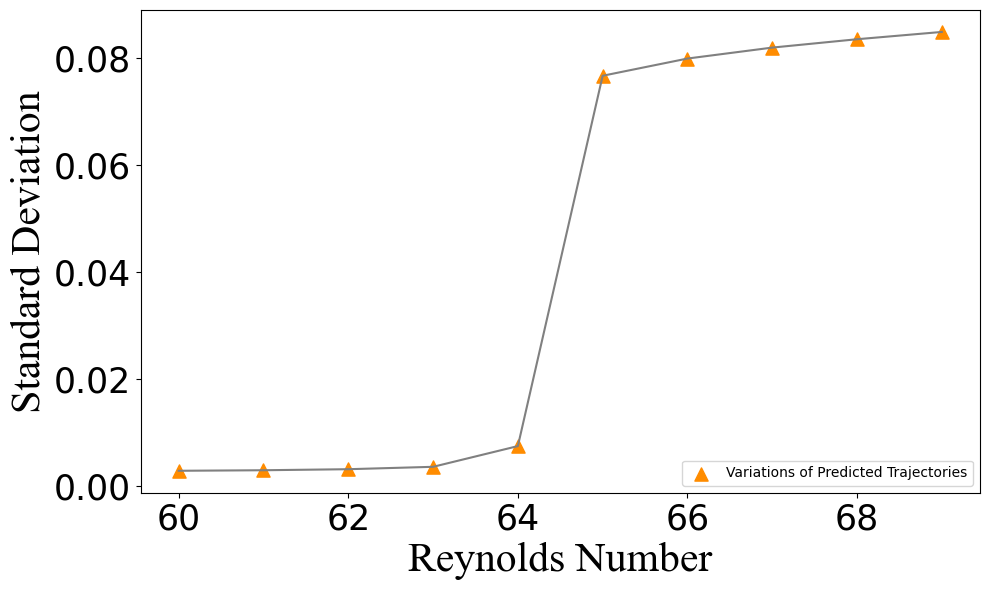

In [21]:
bif_std = np.mean(np.std(Phi_ms_hat_bif.detach().cpu().numpy(), axis = 1), axis = 1)

plt.figure(figsize=(10, 6))

plt.plot(Re_arr_bif, bif_std, color='grey')
plt.scatter(Re_arr_bif, bif_std, color='darkorange', marker='^', s=90, label='Variations of Predicted Trajectories')
plt.locator_params(axis='y', nbins=5)
plt.xlabel('Reynolds Number', **csfont)
plt.ylabel('Standard Deviation', **csfont)
plt.tight_layout()
plt.legend(loc='lower right', fontsize=10)
plt.show()

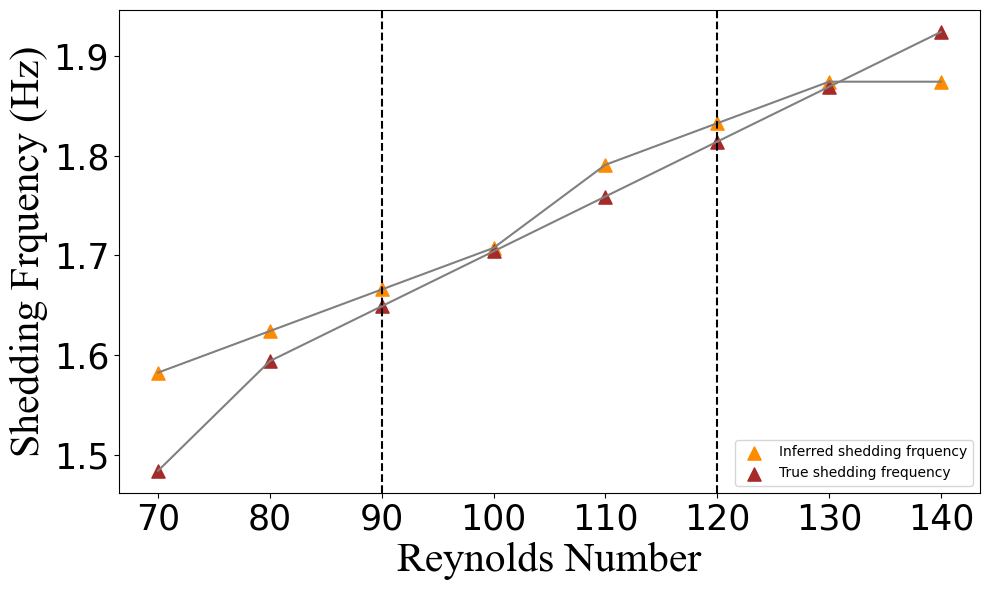

In [22]:

Ts = 0.012
fs = 1/Ts

def get_freq(k, fs) : 
    
    N = len(k)
    K = np.fft.fft(k)
    frequencies = np.fft.fftfreq(N, d=1/fs)
    positive_freqs = frequencies[:N // 2]
    magnitude_spectrum = np.abs(K[:N // 2])
    magnitude_spectrum[0:10] = 0
    main_index = np.argmax(magnitude_spectrum)
    main_frequency = positive_freqs[main_index]
    return main_frequency

frequencies_re_true = []
frequencies_re_pred = []
for i in range(k.shape[0]) : 
    frequencies_re_true.append(get_freq(k[i,:],fs))
    frequencies_re_pred.append(get_freq(k_ms_pred[i,:],fs))

plt.figure(figsize=(10, 6))
plt.plot(Re_arr[2:], frequencies_re_pred[2:], color='grey')
plt.scatter(Re_arr[2:], frequencies_re_pred[2:], color='darkorange', marker='^', s=90, label='Inferred shedding frquency')
plt.plot(Re_arr[2:], frequencies_re_true[2:], color='grey')
plt.scatter(Re_arr[2:], frequencies_re_true[2:], color='brown', marker='^', label='True shedding frequency', s=90)
plt.locator_params(axis='y', nbins=5)
plt.axvline(x=90, color='black', linestyle='--', alpha = 1)
plt.axvline(x=120, color='black', linestyle='--', alpha = 1)
plt.xlabel('Reynolds Number', **csfont)
plt.ylabel('Shedding Frquency (Hz)', **csfont)
plt.tight_layout()
plt.legend(loc='lower right', fontsize=10)
plt.show()

In [22]:
Re = 140 #Select a Reynolds Number 
N = 20 #Ensemble size 
index = Re_arr.index(Re)
context = torch.tensor([Re/140], dtype = torch.float32).to(device).unsqueeze(0)
context = context.repeat(T, 1)
Phi = torch.tensor(inferred_traj[index, ...], dtype = torch.float32).to(device)
Phi_n_ens = models.variational_UQ_scale(Phi, context, N).detach().cpu().numpy()

print(Phi_n_ens.shape)

(20, 1516, 6550)


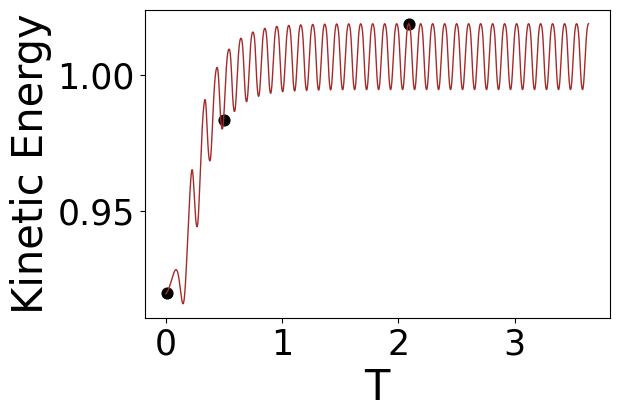

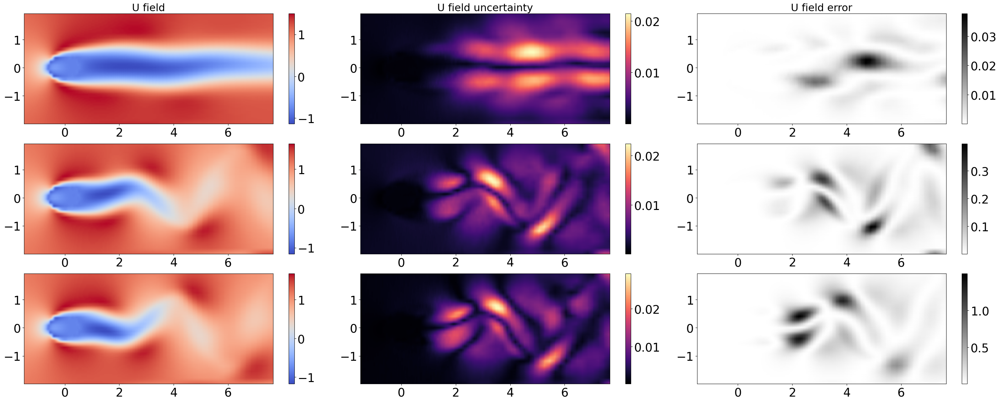

In [23]:
U_n_ens = Phi_n_ens[..., :D//2]
U_err = err_L2[index, :, :D//2]
U =  true_traj[index, :, :D//2]
V = true_traj[index, :, D//2:]

UQ_U = np.std(U_n_ens, axis = 0)
k = energy(U,V)

i_values = [3, 207, 871] #Choose time indices, 207 is in the transition, 807 is in the limit cycle 

plt.figure(figsize=(6, 4))
plt.scatter(np.array(i_values)*0.0024, k[i_values], label = "Selected snapochots", s = 60, color = "black")
plt.plot(np.arange(T) * 0.0024, k, label="Kinetic Energy", color="brown", linewidth = 1)
plt.xlabel(r"T")
plt.ylabel("Kinetic Energy")
plt.show()


fig, axes = plt.subplots(len(i_values), 3, figsize=(30, 4 * len(i_values)))

titles = ["U field", "U field uncertainty", "U field error"]
for idx, i in enumerate(i_values):

    U_grid = reshape_to_grid(U[i, ...])
    U_err_grid = reshape_to_grid(U_err[i, ...])
    UQ_U_grid = reshape_to_grid(UQ_U[i, ...])
                                                                               
    colormap = axes[idx, 0].pcolormesh(X, Y, U_grid, cmap='coolwarm', shading='gouraud')
    fig.colorbar(colormap, ax=axes[idx, 0])

    if idx == 0: 
        axes[idx, 0].set_title(titles[0], fontsize=22)

    colormap = axes[idx, 1].pcolormesh(X, Y, UQ_U_grid, cmap='magma', shading='gouraud')
    fig.colorbar(colormap, ax=axes[idx, 1])

    if idx == 0:  
        axes[idx, 1].set_title(titles[1], fontsize=22)

    colormap = axes[idx, 2].pcolormesh(X, Y, U_err_grid, cmap='binary', shading='gouraud')
    fig.colorbar(colormap, ax=axes[idx, 2])

    if idx == 0:
        axes[idx, 2].set_title(titles[2], fontsize=22)

plt.tight_layout()
plt.show()

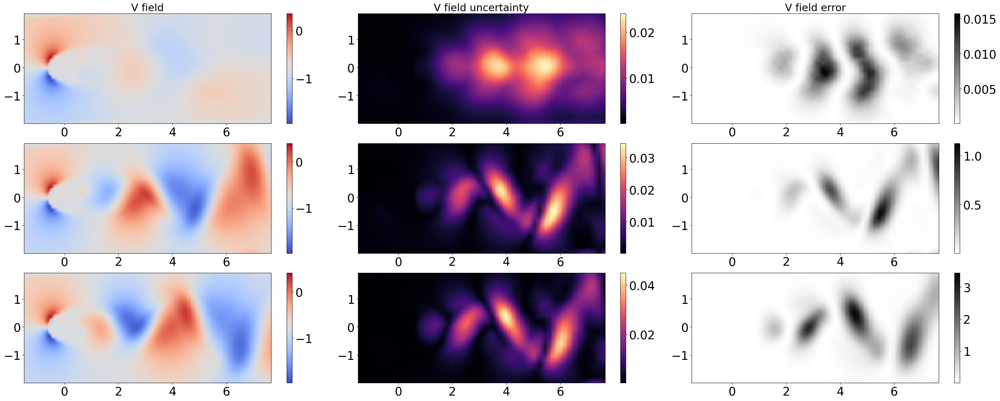

In [24]:
V_n_ens = Phi_n_ens[..., D//2:]
V_err = err_L2[index, :, D//2:]
UQ_V = np.std(V_n_ens, axis = 0)

fig, axes = plt.subplots(len(i_values), 3, figsize=(30, 4 * len(i_values)))

titles = ["V field", "V field uncertainty", "V field error"]
for idx, i in enumerate(i_values):

    V_grid = reshape_to_grid(V[i, ...])
    V_err_grid = reshape_to_grid(V_err[i, ...])
    UQ_V_grid = reshape_to_grid(UQ_V[i, ...])
                                                                               
    colormap = axes[idx, 0].pcolormesh(X, Y, V_grid, cmap='coolwarm', shading='gouraud')
    fig.colorbar(colormap, ax=axes[idx, 0])

    if idx == 0: 
        axes[idx, 0].set_title(titles[0], fontsize=22)

    colormap = axes[idx, 1].pcolormesh(X, Y, UQ_V_grid, cmap='magma', shading='gouraud')
    fig.colorbar(colormap, ax=axes[idx, 1])

    if idx == 0:  
        axes[idx, 1].set_title(titles[1], fontsize=22)

    colormap = axes[idx, 2].pcolormesh(X, Y, V_err_grid, cmap='binary', shading='gouraud')
    fig.colorbar(colormap, ax=axes[idx, 2])

    if idx == 0:
        axes[idx, 2].set_title(titles[2], fontsize=22)

plt.tight_layout()
plt.show()

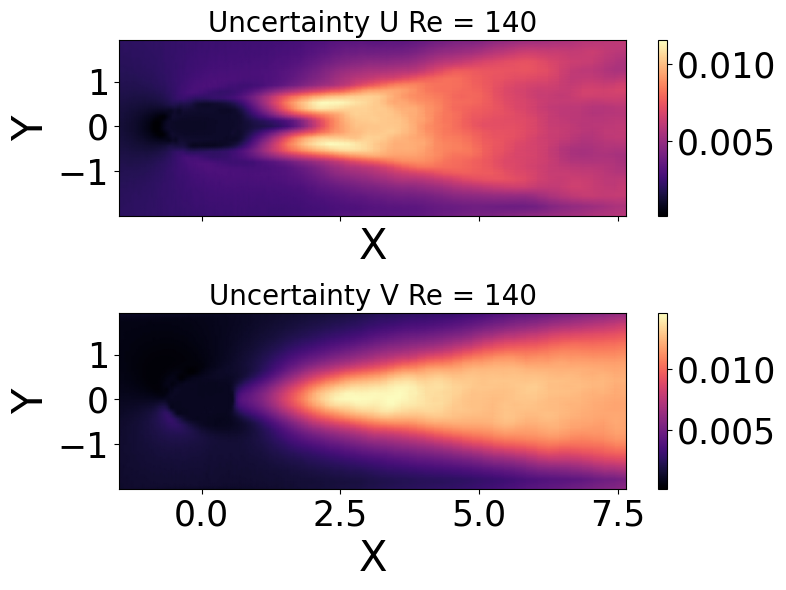

In [32]:
UQ_U_mean = reshape_to_grid(np.mean(UQ_U, axis = 0))
UQ_V_mean = reshape_to_grid(np.mean(UQ_V, axis = 0))

fig, axs = plt.subplots(2, 1, figsize=(7, 6), sharex=True)

c0 = axs[0].pcolormesh(X, Y, UQ_U_mean, cmap='magma', shading='gouraud')
fig.colorbar(c0, ax=axs[0])
axs[0].set_xlabel("X")
axs[0].set_ylabel("Y")
axs[0].set_title(f"Uncertainty U Re = {Re}", fontsize=20)


c1 = axs[1].pcolormesh(X, Y, UQ_V_mean, cmap='magma', shading='gouraud')
fig.colorbar(c1, ax=axs[1])
axs[1].set_xlabel("X")
axs[1].set_ylabel("Y")
axs[1].set_title(f"Uncertainty V Re = {Re}", fontsize=20)

plt.tight_layout()
plt.show()

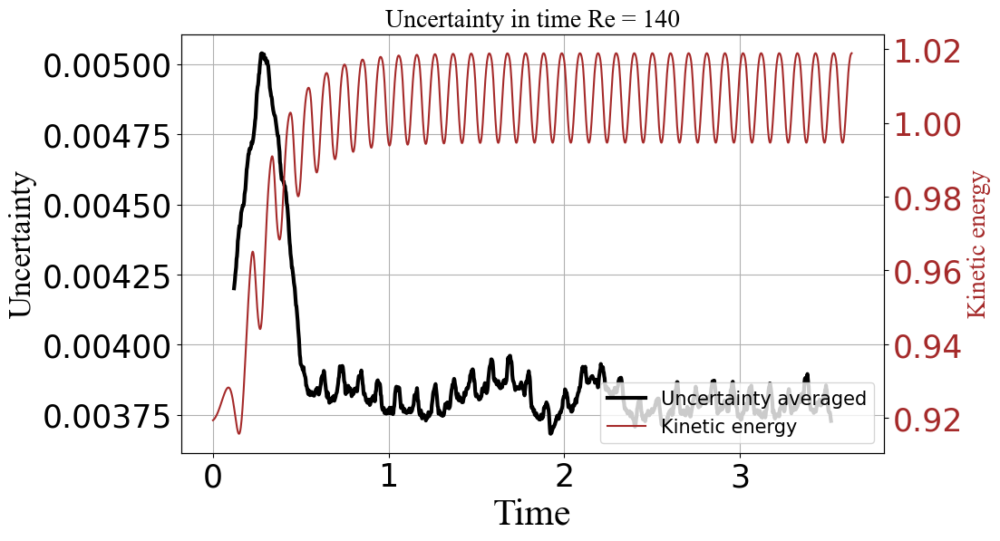

In [27]:
def moving_average(data, window_size):
    return np.convolve(data, np.ones(window_size) / window_size, mode='valid')

window_size = 100

k = energy(U,V)

sigma_t = np.mean(np.std(Phi_n_ens, axis = 0), axis = -1)
sigma_t_smoothed = moving_average(sigma_t, window_size)

x = np.arange(sigma_t_smoothed.size)

fig, ax1 = plt.subplots(figsize=(10, 6))

# ax1.plot(np.arange(sigma_t.shape[-1])*0.0024, sigma_t, color="grey", label="Uncertainty", linewidth=1, alpha=0.5)
ax1.plot((x + window_size/2)*0.0024, sigma_t_smoothed, color="black", label="Uncertainty averaged", linewidth=3, alpha=1)
ax1.set_xlabel('Time', **csfont)
ax1.set_ylabel('Uncertainty', color='black', fontsize=25, fontname='Times New Roman')
ax1.tick_params(axis='y', labelcolor='black')

ax2 = ax1.twinx()

ax2.plot(np.arange(T)*0.0024, k, label='Kinetic energy', color='brown')
ax2.set_ylabel('Kinetic energy', color='brown', fontsize=20, fontname='Times New Roman')
ax2.tick_params(axis='y', labelcolor='brown')

# Title and grid
plt.title(f"Uncertainty in time Re = {Re}", fontsize=20, fontname='Times New Roman')
ax1.grid(True)

lines_1, labels_1 = ax1.get_legend_handles_labels()
lines_2, labels_2 = ax2.get_legend_handles_labels()
ax1.legend(lines_1 + lines_2, labels_1 + labels_2, fontsize=15, loc='lower right')

plt.show()


In [28]:
sigma_list = []
N = 20 #ensemble size
for index, param in enumerate(Re_arr) :

    context = torch.tensor([param/140], dtype = torch.float32).to(device).unsqueeze(0)
    context = context.repeat(T, 1)
    Phi = torch.tensor(inferred_traj[index, ...], dtype = torch.float32).to(device)
    Phi_n_ens = models.variational_UQ_scale(Phi, context, N).detach().cpu().numpy()

    sigma_Phi = np.std(Phi_n_ens, axis = 0)
    sigma_list.append(np.mean(sigma_Phi))
    
uncertainty_Phi = np.array(sigma_list)

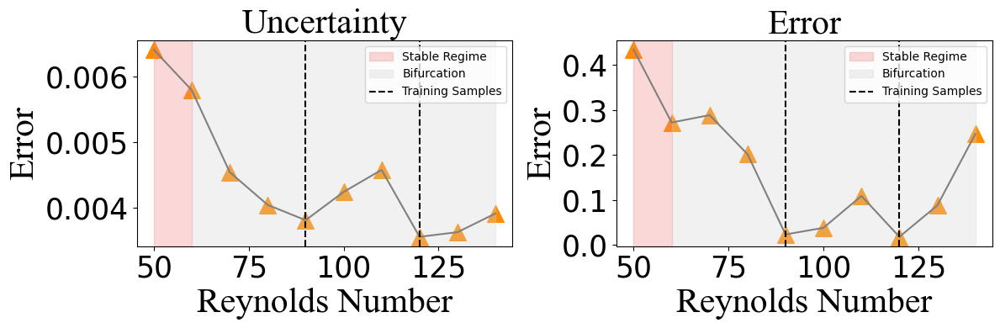

In [29]:
from scipy.stats import pearsonr, linregress

fig, axs = plt.subplots(1,2, figsize=(12,4)) 

axs[0].plot(Re_arr, uncertainty_Phi, color='grey')
axs[0].scatter(Re_arr, uncertainty_Phi, color='darkorange', marker='^', s=200)
axs[0].axvspan(Re_arr[0], 60, color='lightcoral', alpha=0.3, label='Stable Regime')
axs[0].axvspan(60, Re_arr[-1], color='lightgrey', alpha=0.3, label='Bifurcation')
axs[0].axvline(x=90, color='black', linestyle='--', alpha=1, label='Training Samples')
axs[0].axvline(x=120, color='black', linestyle='--', alpha=1)
axs[0].locator_params(axis='y', nbins=5)
axs[0].legend(loc='upper right', fontsize=10)
axs[0].set_xlabel('Reynolds Number', **csfont)
axs[0].set_ylabel('Error', **csfont)
axs[0].set_title('Uncertainty', **csfont, fontsize = 30)

axs[1].plot(Re_arr, error_list, color='grey')
axs[1].scatter(Re_arr, error_list, color='darkorange', marker='^', s=200)
axs[1].axvspan(Re_arr[0], 60, color='lightcoral', alpha=0.3, label='Stable Regime')
axs[1].axvspan(60, Re_arr[-1], color='lightgrey', alpha=0.3, label='Bifurcation')
axs[1].axvline(x=90, color='black', linestyle='--', alpha=1, label='Training Samples')
axs[1].axvline(x=120, color='black', linestyle='--', alpha=1)
axs[1].locator_params(axis='y', nbins=5)
axs[1].legend(loc='upper right', fontsize=10)
axs[1].set_xlabel('Reynolds Number', **csfont)
axs[1].set_ylabel('Error', **csfont)
axs[1].set_title('Error', **csfont, fontsize = 30)


plt.tight_layout()
plt.show()